# 教程 6：Theta 扫描系统模型（头向细胞 + 网格细胞）

> **阅读时间**：约 40-45 分钟
> **难度**：高级
> **前置条件**：[教程 1-5](./01_build_cann_model.ipynb)

本教程介绍了结合头向（HD）细胞和网格细胞的 theta 扫描系统，采用 theta 调制动力学实现逼真的神经导航。

---

## 目录

1. [Theta扫描简介](#1-introduction-to-theta-sweeps)
2. [模型架构](#2-model-architecture)
3. [完整示例：Theta调制导航](#3-complete-example-theta-modulated-navigation)
4. [可视化和分析](#4-visualization-and-analysis)
5. [后续步骤](#5-next-steps)

---

## 1. Theta扫描介绍

### 1.1 什么是Theta扫描？

**Theta振荡**（4-12 Hz）是导航期间突出的有节奏脑波。**Theta扫描**是指神经元放电相对于theta周期的系统相位移动：

- **相位前移**：随着动物的移动，神经元在theta周期中的放电时间逐渐提前
- **预期编码**：神经活动"超前"当前位置
- **速度调制**：Theta频率和振幅随运动速度变化

### 1.2 生物学基础

啮齿动物的实验观察：
- **头方向（HD）细胞**相对于转向角显示相位前移
- **网格细胞**在运动中表现出theta扫描
- **Theta功率**随跑步速度增加而增加
- **相位关系**协调脑区之间的信息

### 1.3 计算意义

Theta扫描提供：
- **预测编码**：在快速运动时预测未来状态
- **时间压缩**：在单个theta周期内编码序列
- **错误修正**：比较预测位置和实际位置
- **记忆巩固**：促进休息期间的海马体重放

### 1.4 最近的研究

本教程实现了以下模型：
- **Ji et al. (2025)** - "Phase Precession Relative to Turning Angle in Theta-Modulated Head Direction Cells", *Hippocampus*, 35(2)
- **Ji et al. (2025)** - "A systems model of alternating theta sweeps via firing rate adaptation", *Current Biology*, 35(4)

---

## 2. 模型架构

### 2.1 组件概览

theta扫描系统由两个耦合网络组成：

In [ ]:
from canns.models.basic.theta_sweep_model import (
    DirectionCellNetwork,
    GridCellNetwork,
    calculate_theta_modulation
)

# 创建头向细胞网络
dc_net = DirectionCellNetwork(
    num=100,                   # 方向细胞数量
    adaptation_strength=15.0,  # 尖峰频率自适应
    noise_strength=0.0        # 活动噪声
)

# 创建网格细胞网络
gc_net = GridCellNetwork(
    num_dc=100,               # 方向细胞（与dc_net匹配）
    num_gc_x=100,             # 每个维度的网格细胞
    adaptation_strength=8.0,   # SFA强度
    mapping_ratio=5,          # 控制网格间距
    noise_strength=0.0
)

### 2.2 关键参数

**DirectionCellNetwork**:

| 参数 | 默认值 | 说明 |
|-----------|---------|-------------|
| `num` | 100 | 方向细胞数量 |
| `adaptation_strength` | 15.0 | 峰值频率自适应 (SFA) 强度 |
| `noise_strength` | 0.1 | 活动噪声水平 |
| `tau` | 10.0 | 膜时间常数 |
| `tau_v` | 100.0 | 自适应时间常数 |
| `k` | 0.2 | 全局抑制强度 |

**GridCellNetwork**:

| 参数 | 默认值 | 说明 |
|-----------|---------|-------------|
| `num_dc` | 100 | 方向细胞输入数量 |
| `num_gc_x` | 100 | 每个空间维度的网格细胞数 |
| `adaptation_strength` | 15.0 | SFA 强度 |
| `mapping_ratio` | 1 | 网格间距控制（越大 = 间距越小） |
| `phase_offset` | 1.0/20 | 驱动 theta 扫描（[-π,π] 的分数） |
| `noise_strength` | 0.1 | 活动噪声 |

**参数指南**:
- 更高的 `adaptation_strength`：更强的 theta 扫描，更多相位前移
- `mapping_ratio`：决定网格细胞间距（5 = 典型环境中约 30cm 的网格间距）
- `phase_offset`：控制扫描幅度（1/20 在大多数情况下效果很好）

### 2.3 Theta 调制机制

**峰值频率自适应** (SFA) 创建类似 theta 的振荡：
1. 活跃的神经元累积自适应电流 (`v`)
2. 自适应电流抑制放电
3. 创建振荡凸起动力学
4. 速度和转向调节振荡幅度

---

## 3. 完整示例：θ调制导航

### 3.1 设置和任务创建

In [2]:
import numpy as np
import brainstate
import brainunit as u
from canns.task.open_loop_navigation import OpenLoopNavigationTask
from canns.models.basic.theta_sweep_model import (
    DirectionCellNetwork,
    GridCellNetwork,
    calculate_theta_modulation
)

# 设置
np.random.seed(10)
env_size = 1.5  # 米
simulate_time = 2.0  # 秒
dt = 0.001  # 仿真时间步长

brainstate.environ.set(dt=1.0)

# 创建导航任务
task = OpenLoopNavigationTask(
    duration=simulate_time,
    initial_head_direction=11/12 * u.math.pi,  # 起始角度
    width=env_size,
    height=env_size,
    start_pos=[env_size * 15/16, env_size * 1/16],  # 右上角
    speed_mean=2.0,           # m/s
    speed_std=0.0,            # 恒定速度
    dt=dt,
    speed_coherence_time=10,
    rotational_velocity_std=40 * np.pi / 180,  # 40 度/秒标准差
)

# 生成轨迹
task.get_data()

# 重要：计算theta扫过参数
task.calculate_theta_sweep_data()

print(f"轨迹：{task.total_steps} 步")
print(f"持续时间：{simulate_time}s")

<OpenLoopNavigationTask>Generating Task data: 100%|██████████| 2000/2000 [00:00<00:00, 1028267.71it/s]

Trajectory: 2000 steps
Duration: 2.0s


**关键方法**：`calculate_theta_sweep_data()` 计算：
- `linear_speed_gains`：归一化前向速度 [0, 1]
- `ang_speed_gains`：归一化角速度 [-1, 1]
- 这些调制 theta 振荡幅度

### 3.2 创建网络

In [4]:
# 创建方向细胞网络
dc_net = DirectionCellNetwork(
    num=100,
    adaptation_strength=15,  # 强SFA以获得清晰的theta
    noise_strength=0.0,      # 无噪声以进行清洁演示
)

# 创建网格细胞网络
mapping_ratio = 5  # 控制网格间距
gc_net = GridCellNetwork(
    num_dc=dc_net.num,
    num_gc_x=100,
    adaptation_strength=8,   # 中等SFA
    mapping_ratio=mapping_ratio,
    noise_strength=0.0,
)

# 初始化状态
dc_net.init_state()
gc_net.init_state()

print(f"方向细胞: {dc_net.num}")
print(f"网格细胞: {gc_net.num_gc_1side} x {gc_net.num_gc_1side}")

Direction cells: 100
Grid cells: 100 x 100


### 3.3 Theta调制的主要仿真

In [5]:
# 提取任务数据
position = task.data.position
direction = task.data.hd_angle
linear_speed_gains = task.data.linear_speed_gains
ang_speed_gains = task.data.ang_speed_gains

def run_step(i, pos, hd_angle, linear_gain, ang_gain):
    """单个步骤，带有theta调制"""

    # 计算theta相位和调制
    theta_phase, theta_mod_hd, theta_mod_gc = calculate_theta_modulation(
        time_step=i,
        linear_gain=linear_gain,      # 前向速度影响
        ang_gain=ang_gain,             # 转向速度影响
        theta_strength_hd=1.0,         # HD theta调制强度
        theta_strength_gc=0.5,         # 网格theta调制强度
        theta_cycle_len=100.0,         # Theta周期 = 100个时间步
        dt=dt,
    )

    # 用theta调制更新方向细胞
    dc_net(hd_angle, theta_mod_hd)
    dc_activity = dc_net.r.value

    # 用方向输入和theta调制更新网格细胞
    gc_net(pos, dc_activity, theta_mod_gc)
    gc_activity = gc_net.r.value

    # 返回用于分析的状态
    return (
        gc_net.center_position.value,  # 解码的网格位置
        dc_net.center.value,            # 解码的头部方向
        gc_activity,                     # 网格细胞活动
        gc_net.gc_bump.value,           # 网格隆起状态
        dc_activity,                     # 方向细胞活动
        theta_phase,                     # 当前theta相位
        theta_mod_hd,                    # HD theta调制
        theta_mod_gc,                    # 网格theta调制
    )

# 运行模拟
print("运行theta调制模拟...")
results = brainstate.transform.for_loop(
    run_step,
    u.math.arange(len(position)),
    position,
    direction,
    linear_speed_gains,
    ang_speed_gains,
    pbar=brainstate.transform.ProgressBar(10),
)

# 解包结果
(
    internal_position,
    internal_direction,
    gc_activity,
    gc_bump,
    dc_activity,
    theta_phase,
    theta_mod_hd,
    theta_mod_gc,
) = results

print("模拟完成！")
print(f"内部位置追踪形状: {internal_position.shape}")
print(f"网格细胞活动形状: {gc_activity.shape}")

Running theta-modulated simulation...


  0%|          | 0/2000 [00:00<?, ?it/s]

Simulation complete!
Internal position tracking shape: (2000, 2)
Grid cell activity shape: (2000, 10000)


**理解theta调制**：
- `theta_phase`: 在theta频率下在-π和π之间振荡
- `theta_mod_hd/gc`: 乘法调制（通常0.5到1.5）
- **速度依赖性**: 更快的运动→更强的调制→更大的扫描

---

## 4. 可视化和分析

### 4.1 带Theta叠加的群体活动

可视化方向细胞相对于theta相位的放电情况：

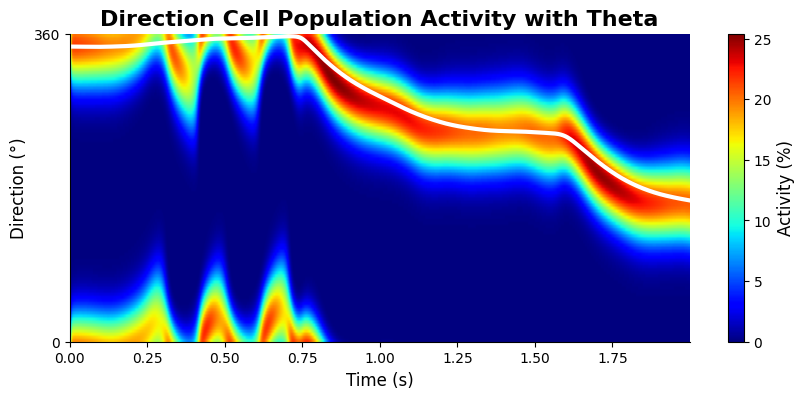

(<Figure size 1000x400 with 2 Axes>,
 <Axes: title={'center': 'Direction Cell Population Activity with Theta'}, xlabel='Time (s)', ylabel='Direction (°)'>)

In [6]:
from canns.analyzer.theta_sweep import plot_population_activity_with_thetafrom canns.analyzer.plotting import PlotConfigs# 配置绘图config_pop = PlotConfigs.theta_population_activity_static(    title="Direction Cell Population Activity with Theta",    xlabel="Direction (°)",    ylabel="__PLOT_PARAM_2__",    figsize=(10, 4),    show=True,    save_path=None)# 绘制种群活动plot_population_activity_with_theta(    time_steps=task.run_steps * dt,  # 转换为秒    theta_phase=theta_phase,    net_activity=dc_activity,    direction=direction,    config=config_pop,    add_lines=True,     # 添加theta相位线    atol=5e-2,          # 线检测的容差)

**观察要点**:
- **对角条纹**：方向改变时的相位进动
- **Theta线**：叠加的相位标记显示振荡
- **速度效应**：转向越快 → 相位进动越清晰

### 4.2 扭转环面上的网格细胞活动

网格细胞存在于扭转环面流形上。在此空间中可视化活动：

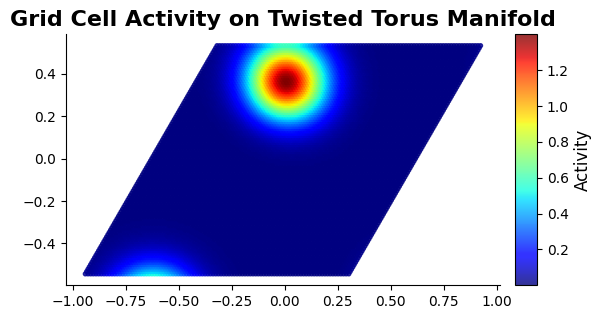

(<Figure size 600x500 with 2 Axes>,
 <Axes: title={'center': 'Grid Cell Activity on Twisted Torus Manifold'}>)

In [7]:
from canns.analyzer.theta_sweep import plot_grid_cell_manifold

# 将网格位置变换到扭曲的环面坐标
value_grid_twisted = np.dot(
    gc_net.coor_transform_inv,
    gc_net.value_grid.T
).T

# 重塑网格细胞活动
grid_cell_activity = gc_activity.reshape(
    -1,
    gc_net.num_gc_1side,
    gc_net.num_gc_1side
)

# 选择一帧进行可视化
frame_idx = 900

# 配置绘图
config_manifold = PlotConfigs.grid_cell_manifold_static(
    title="Grid Cell Activity on Twisted Torus Manifold",
    figsize=(6, 5),
    show=True,
    save_path=None
)

# 绘制流形
plot_grid_cell_manifold(
    value_grid_twisted=value_grid_twisted / mapping_ratio,
    grid_cell_activity=grid_cell_activity[frame_idx],
    config=config_manifold,
)

**解释**：
- **凸起位置**：活动峰值在环面上的位置
- **环面拓扑**：网格单元在边界处周期性环绕
- **六边形结构**：从扭曲的环面几何中产生

### 4.3 Theta扫描动画

创建显示所有组件的综合动画：

In [9]:
from canns.analyzer.theta_sweep import create_theta_sweep_grid_cell_animation

# 配置动画
config_anim = PlotConfigs.theta_sweep_animation(
    figsize=(12, 3),
    fps=10,
    show=True
)

# 创建动画
animation = create_theta_sweep_grid_cell_animation(
    position_data=position,
    direction_data=direction,
    dc_activity_data=dc_activity,
    gc_activity_data=gc_activity,
    gc_network=gc_net,
    env_size=env_size,
    mapping_ratio=mapping_ratio,
    dt=dt,
    config=config_anim,
    n_step=10,                # 每10帧采样一次
    show_progress_bar=True,
    render_backend="auto",    # 自动选择最佳后端
    output_dpi=120,
)

[theta_sweep] Using imageio backend for theta sweep animation (auto-detected).
[theta_sweep] Auto-selected imageio backend requires save_path; falling back to Matplotlib.


**动画展示**:
1. **轨迹面板**: 动物在环境中的路径
2. **方向细胞**: 环形吸引子追踪头部方向
3. **网格细胞**: 二维凸起活动
4. **Theta相位**: 当前在theta循环中的位置

---

## 5. 后续步骤

恭喜！你已经学会了如何实现和分析包含头方向细胞和网格细胞的theta扫描系统。

### 主要要点

1. **尖峰频率自适应**在没有显式振荡器的情况下产生theta振荡
2. **相位前驱**从速度调制的自适应中涌现
3. **方向细胞和网格细胞**通过联合输入相互作用
4. **Theta调制**取决于线性和角速度
5. **可视化工具**揭示相位关系和流形结构

### 何时使用Theta扫描模型

- **现实的导航动力学**：匹配实验观察
- **预测编码研究**：研究预期的神经活动
- **多时间尺度处理**：结合快速动力学（theta）和慢速记忆
- **相位编码**：研究空间编码的时间方面
- **生物学验证**：与啮齿动物导航数据比较

### 参数调优技巧

- **更强的扫描**：增加`adaptation_strength`
- **更快的theta**：减少`theta_cycle_len`
- **网格间距**：调整`mapping_ratio`（更大=更小的网格）
- **扫描幅度**：调节GridCellNetwork中的`phase_offset`
- **噪声鲁棒性**：添加`noise_strength`以获得现实条件

### 继续学习

- **下一步**：[教程7：Theta扫描位置细胞网络](./07_theta_sweep_place_cell.ipynb) - 将theta扫描应用于复杂环境
- **替代方案**：探索其他场景进行数据分析或脑启发学习

### 高级主题

- **交替扫描**：实现双向相位前驱
- **多尺度theta**：与层级网络结合（教程5）
- **回放序列**：使用theta扫描进行记忆巩固
- **实验比较**：根据神经记录进行验证

### 相关研究

本教程中的模型实现了以下研究的发现：
- **Ji, Z., Ji, J., Du, J., & Wu, S. (2025)**. Phase Precession Relative to Turning Angle in Theta-Modulated Head Direction Cells. *Hippocampus*, 35(2).
- **Ji, Z., Chu, H., Wang, R., Du, J., & Wu, S. (2025)**. A systems model of alternating theta sweeps via firing rate adaptation. *Current Biology*, 35(4).

有关实现细节，请参阅`canns.models.basic.theta_sweep_model`中的源代码和`canns.analyzer.theta_sweep`中的可视化工具。